#  Классификация областей леса по спутниковым снимкам 

__Задача.__ Обучить модель бинарной классификации областей леса на повреждённые и неповреждённые и оценить результат.

__Методы обучения.__ Приведены примеры использования RandomForest и XGBoost. Можете выбрать одну из этих моделей или любую другую. 

__Оценка результатов.__ Нужно оценить качество бинарной сегментации (рекомендуются метрики Dice или IoU), а также визуализировать результирующие маски. 

__Дополнительное задание.__ Сравнить результаты обучения двух разных моделей или сравнить результаты без/с морфологическими преобразованиями. 

__Данные.__ Многоспектральные спутниковые снимки, разрезанные на части 256х256 пикселей и объединённые в пары старый-новый.

Для обнаружения лесных повреждений мы должны сравнить пары старых и новых снимков. В простейшем случае для этого достаточно вычесть одно изображение из другого (это же матрицы), а затем рассмотреть, для каких пикселей разность сильно отличается от нуля. Понятное дело в реальности дело осложняется разными условиями съёмки, дефектами и т.д., так что не лишним является применение методов машинного обучения. 

In [129]:
from PIL import Image
import os
from skimage import io
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib import colors
import matplotlib as mpl
from PIL import ImageEnhance

import glob
import random
from tqdm import tqdm

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

np.random.seed(257)

In [ ]:
import cv2

Скорее всего вам придётся доустановить cv2 с помощью !pip install opencv-python (запустите это прямо в ячейке). cv2 нужна только для дополнительной части.

# Исследование данных

Эта часть нужна для понимания, но в общем-то можете не вдумываться в большую часть этого. Здесь определяются несколько функций для визуализации, а также для получения разностей между каналами (ndvi), которые будут использоваться в дальнейшем. 

Скачайте данные для обучения и распакуйте в директорию вместе с .ipynb. В архиве находятся изображения со спутника Sentinel-2 в формате geoTiff, разрезанные на куски 256×256 пикселей. GeoTiff - это подмножество формата хранения растровых графических изображений tiff, в котором содержится дополнительная геоинформация. Для получения этой геоинформации (например, координат снимков) можно использовать множество библиотек, в том числе GDAL, но для текущих задач это не нужно.

In [130]:
local_download_path = "tiles_256_256_27_after_check/"

В директории содержатся как снимки с объектами (with_object), так и без них (no_object). 

In [131]:
os.listdir(local_download_path + 'T40VEM_pair_0.tif')

['T40VEM_pair_0.tif_289_5875_with_object.tif',
 'T40VEM_pair_0.tif_6258_5319_no_object.tif',
 'T40VEM_pair_0.tif_5958_10612_no_object.tif',
 'T40VEM_pair_0.tif_9583_6035_with_object.tif',
 'T40VEM_pair_0.tif_9511_5746_with_object.tif',
 'T40VEM_pair_0.tif_2183_518_no_object.tif',
 'T40VEM_pair_0.tif_2742_6434_no_object.tif',
 'T40VEM_pair_0.tif_854_3960_no_object.tif',
 'T40VEM_pair_0.tif_7386_6868_no_object.tif',
 'T40VEM_pair_0.tif_1044_2836_with_object.tif',
 'T40VEM_pair_0.tif_9856_600_no_object.tif',
 'T40VEM_pair_0.tif_3772_936_no_object.tif',
 'T40VEM_pair_0.tif_9699_5872_with_object.tif',
 'T40VEM_pair_0.tif_10284_6891_with_object.tif',
 'T40VEM_pair_0.tif_1803_8000_with_object.tif',
 'T40VEM_pair_0.tif_10183_9423_no_object.tif',
 'T40VEM_pair_0.tif_9111_1650_no_object.tif',
 'T40VEM_pair_0.tif_9267_8867_no_object.tif',
 'T40VEM_pair_0.tif_8317_695_no_object.tif',
 'T40VEM_pair_0.tif_9892_6865_with_object.tif',
 'T40VEM_pair_0.tif_549_8203_with_object.tif',
 'T40VEM_pair_0.tif_

Объединим пути ко всем изображениям в один список для удобства при дальнейшей работе.

In [132]:
allTiles = []
for tile in list(glob.glob(local_download_path + '*/*with_object.tif')):
    allTiles.append(tile)

Посмотрим на размерность одного из изображений. 

In [20]:
img = io.imread(allTiles[0])/65536

img.shape

(256, 256, 27)

Видим, что изображение - это трёхмерный массив. 256 пикселей по вертикали и по горизонтали, а также 27 каналов "в глубину". Sentinel-2 ведет съёмку не только в 3 привычных каналах видимого спектра (синий, зеленый и красный), но также и в невидимых глазу диапазонах: коротковолновом инфракрасном (SWIR), видимом ближнем инфракрасном (VNIR) и т.д., - всего 13 каналов. 

Канал |	Разрешение	| Центральная длина волны |	Описание
--------|--------|--------|--------
B1	| 60 m	| 443 nm	| Ultra Blue (Coastal and Aerosol)
B2	| 10 m	| 490 nm	| Blue
B3	| 10 m	| 560 nm	| Green
B4	| 10 m	| 665 nm	| Red
B5	| 20 m	| 705 nm	| Visible and Near Infrared (VNIR)
B6	| 20 m	| 740 nm	| Visible and Near Infrared (VNIR)
B7	| 20 m	| 783 nm	| Visible and Near Infrared (VNIR)
B8	| 10 m	| 842 nm	| Visible and Near Infrared (VNIR)
B8a	| 20 m	| 865 nm	| Visible and Near Infrared (VNIR)
B9	| 60 m	| 940 nm	| Short Wave Infrared (SWIR)
B10	| 60 m	| 1375 nm   | Short Wave Infrared (SWIR)
B11	| 20 m	| 1610 nm   | Short Wave Infrared (SWIR)
B12	| 20 m	| 2190 nm   | Short Wave Infrared (SWIR)


В наших данных заранее совмещены пары старых снимков (со все ещё с нетронутым лесом) и новых (с повреждением), а также маска (с отмеченным повреждением). Так что всего получается 13+13+1=27 каналов. Порядок их следования в нашем трехмерном массиве следующий:

    Маска - 0 
    Новый снимок
    ["B01","B02","B03","B04","B05","B06","B07","B08","B8A","B09","B10","B11","B12"]
    [ 1,     2,    3,    4,    5,    6,    7,    8,    9,    10,   11,   12,   13  ]
    Старый снимок
    ["B01","B02","B03","B04","B05","B06","B07","B08","B8A","B09","B10","B11","B12"]
    [ 14,    15,   16,   17,   18,   19,   20,   21,   22,   23,   24,   25,   26  ];

В маске разными цифрами указаны следующие классы:
*   1 - Сплошная рубка
*   2 - Проходная рубка
*   3 - Лесная дорога
*   4 - Ветровал
*   5 - Пожар
*   6 - Усыхание (повреждение)
*   7 - Выборочная рубка

Мы собираемся обучать модели всего лишь для бинарной классификации, так что достаточно будет проверять, больше ли нуля значение маски. 

Попробуем посмотреть на один из каналов изображения простейшим способом (2 канал соответствует синему спектру нового снимка)

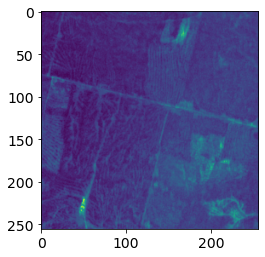

In [27]:
plt.imshow(img[:,:,2])

Привычнее было бы смотреть на RGB-изображение, так что создадим функции для выделения старого и нового набора rgb-каналов. 

In [133]:
def get_rgb_new(img):
    c1 = 4
    c2 = 3
    c3 = 2
    img = np.stack([img[::, ::, c1] / img[::, ::, c1].max() ,
                img[::, ::, c2] / img[::, ::, c2].max(),
                img[::, ::, c3] / img[::, ::, c3].max()], axis=2)
    return img

def get_rgb_old(img):
    c1 = 17
    c2 = 16
    c3 = 15
    img = np.stack([img[::, ::, c1] / img[::, ::, c1].max() ,
                img[::, ::, c2] / img[::, ::, c2].max(),
                img[::, ::, c3] / img[::, ::, c3].max()], axis=2)
    return img

Введём также функцию для симпатичного отображения маски (show_mask) и нормализации яркости и контрастности изображения (show_img_norm). Можете в них слишком не вдумываться. 

In [177]:
def show_mask(data, k):
    labels = ['-', 'Сплошная рубка', 'Проходная рубка', 'Лесная дорога', 'Ветровал', 'Пожар', 'Усыхание', 'Выборочная рубка']
    my_colors = ['g', 'b', 'r', 'black', 'c', 'm', 'y', 'black']
    cmap = colors.ListedColormap(my_colors)
    bounds=[-0.5, 0.5, 1.5, 2.5, 3.5, 4.5, 5.5]
    norm = colors.BoundaryNorm(bounds, cmap.N)
    values = np.unique(data.ravel()).astype(int)
    im = plt.imshow(X=data, cmap=cmap, norm=norm)
    
    patches = [ mpatches.Patch(color=my_colors[values[i]],
                               label=f"{values[i]} : {labels[values[i]]}" ) for i in range(len(values)) ]

    axes[k].legend(loc="lower right", handles=patches, bbox_to_anchor=(1, 1))
    axes[k].set_title('Маска')
    axes[k].axis('off')
    
def show_img_norm(img, k):
    img = (img*255).astype(np.uint8)
    img = Image.fromarray(img, 'RGB')
    
    enhancer = ImageEnhance.Brightness(img)
    factor = 0.8 
    im_output = enhancer.enhance(factor)
    
    enhancer = ImageEnhance.Contrast(im_output)
    factor = 1.3
    im_output = enhancer.enhance(factor)
    
    axes[k].imshow(im_output)
    axes[k].axis('off')

In [138]:
plt.rcParams.update({'font.size': 14})

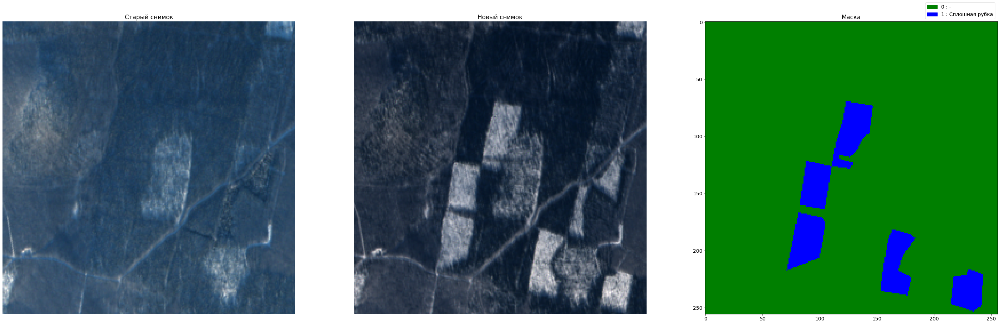

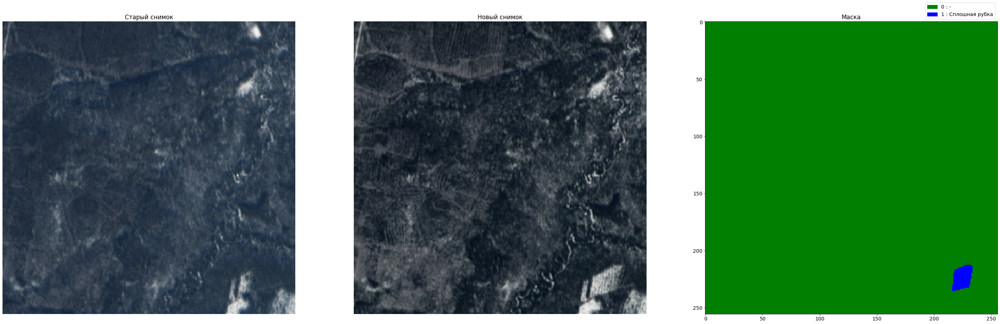

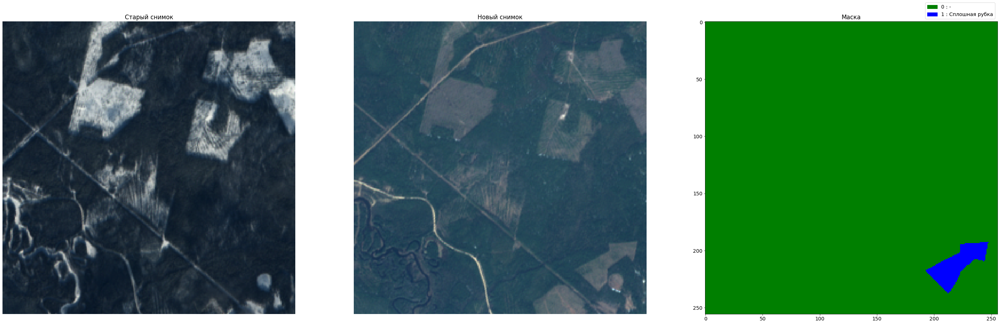

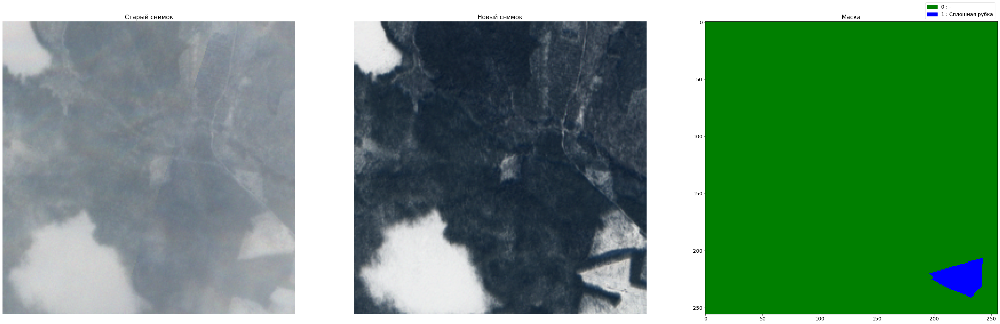

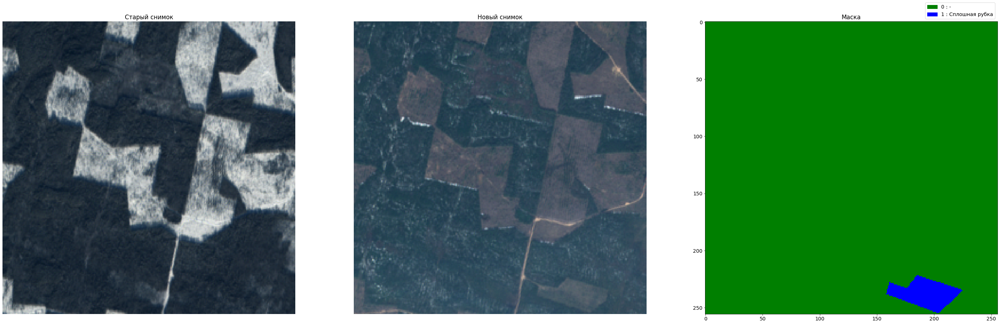

In [146]:
for tileS in random.sample(allTiles, 5):
    img = io.imread(tileS)
    
    fig,axes = plt.subplots(ncols=3,figsize=(50,50))
    plt.title(os.path.basename(tileS))

    show_img_norm(get_rgb_old(img), 0)
    axes[0].set_title('Старый снимок')

    show_img_norm(get_rgb_new(img), 1)
    axes[1].set_title('Новый снимок')

    show_mask( img[:,:,0], 2)

Итак, мы разобрались, как выделить обычную rgb-картинку из спутникового снимка. Данные в невидимых спектрах при этом тоже очень полезны. Например, в инфракрасном диапазоне легче увидеть пожары (данные о теплоте). Кроме этого, можно использовать разные *комбинации* каналов для выявления определенных особенностей изображения. Общеизвестна такая комбинация и для выделения данных о растительности, основанная на особенностях отражения света от листьев.

Для задачи выявления нарушений в состоянии лесного покрова зачастую используют нормализованный разностный индекс растительности (NDVI). Высокие значения NDVI соответствуют областям, которые больше отражают ближний инфракрасный спектр, что соответствует более густой и здоровой растительности.

$$
    NDVI = \frac{NIR - Red}{NIR + Red}
$$

У спутников Sentinel 2 NIR и Red соответствуют каналам B8 и B4. 

Выделим функцию get_ndvi и посмотрим на снимки в этой комбинации каналов.

In [147]:
def get_ndvi(tif):
    eps = 1e-8
    ndvi1 = (tif[::, ::, 4] - tif[::, ::, 3]) \
             / (tif[::, ::, 4] + tif[::, ::, 3] + eps)
    offset = 13
    ndvi2 = (tif[::, ::, offset + 4] - tif[::, ::, offset + 3]) \
            / (tif[::, ::, offset + 4] + tif[::, ::, offset + 3] + eps)
    dif = ndvi1 - ndvi2
    return dif

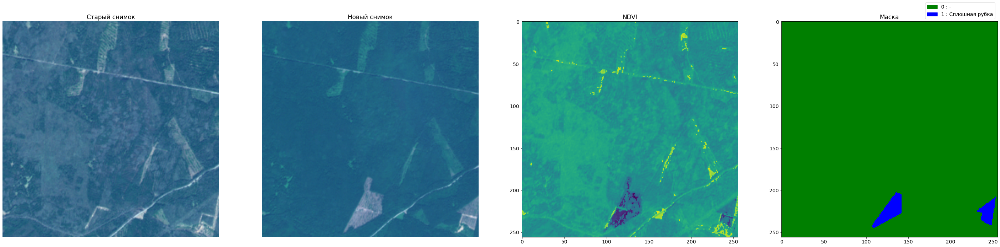

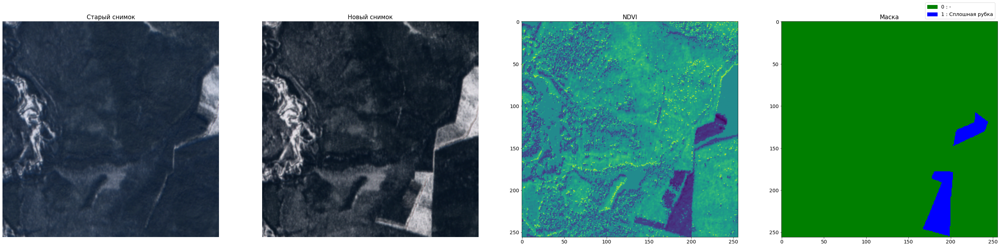

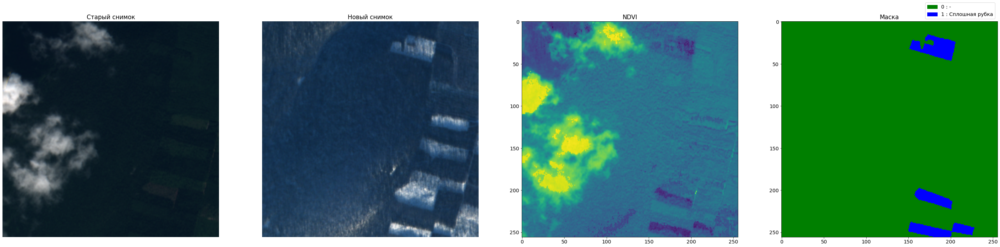

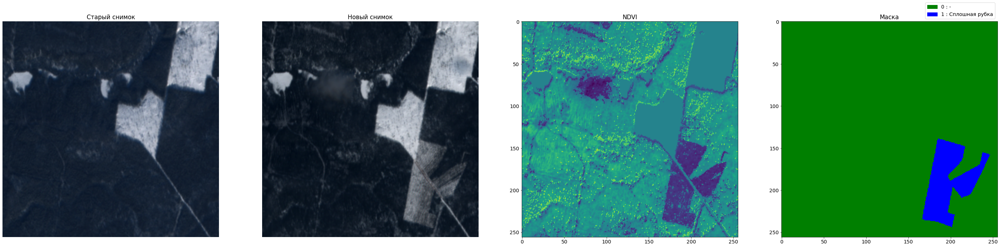

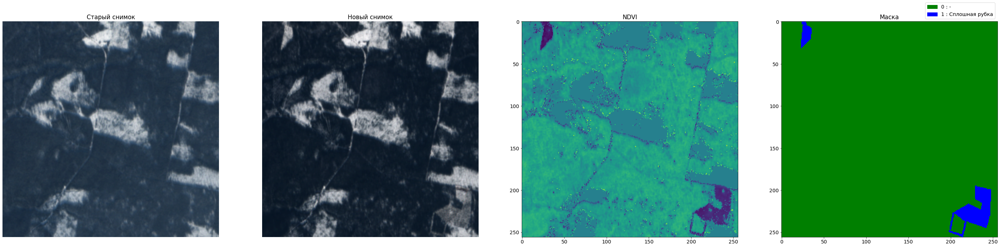

In [149]:
for tileS in random.sample(allTiles, 5):
    img = io.imread(tileS)
    
    fig,axes = plt.subplots(ncols=4,figsize=(50,50))
    plt.title(os.path.basename(tileS))

    show_img_norm(get_rgb_old(img), 0)
    axes[0].set_title('Старый снимок')

    show_img_norm(get_rgb_new(img), 1)
    axes[1].set_title('Новый снимок')

    axes[2].imshow( get_ndvi(img) )
    axes[2].set_title('NDVI')
    
    show_mask( img[:,:,0], 3)

В дальнейшем при обучении добавим NDVI к первоначальному набору каналов. 

# Подготовка данных

In [198]:
allTiles = []
for tile in list(glob.glob(local_download_path + '*/*.tif')):
    allTiles.append(tile)

In [199]:
print(f"Всего снимков: {len(allTiles)}")

Всего снимков: 470


Для работы возьмем 100 изображений, этого оказывается достаточно. Но можете попробовать и другое количество.

In [152]:
allTiles = np.array(allTiles)[:100] 

In [153]:
data = []
for img_path in tqdm(allTiles):
    try:
        img = (io.imread(img_path)).astype('float32')
        data.append(img)
    except Exception as e:
        print(f"Failed to read by path: {img_path}")

100%|██████████| 100/100 [00:00<00:00, 135.09it/s]


In [154]:
data = np.array(data)
data.shape

(100, 256, 256, 27)

На вход модели будем подавать все 26 исходных каналов (13 старых снимков в разных спектрах, 13 новых), а также NDVI индекс, о котором мы говорили в предыдущем разделе. Отделим 25 изображений для дальнейшего тестирования модели.

In [155]:
def add_ndvis(data):
    new_data = []
    for tiff in data:
        ndvi = get_ndvi(tiff).reshape(256, 256, 1)
        new_data.append(np.concatenate((tiff, ndvi), 2))
    return np.array(new_data)

In [156]:
work_data = add_ndvis(data)
train_snaps = work_data[:75]
test_snaps = work_data[75:]

In [157]:
train_snaps.shape

(75, 256, 256, 28)

На вход классических МЛ-моделей должен подаваться одномерный массив. Так что нам придётся "вытянуть" наши изображения 256х256х28 с помощью reshape. 

In [158]:
def prepare_snaps(snaps):
    channels = snaps.shape[-1]
    return snaps.reshape(-1, channels)

In [159]:
X_train = prepare_snaps(train_snaps[:, :, :, 1:])
y_train = train_snaps[:, :, :, 0].reshape(-1, 1)
X_test = prepare_snaps(test_snaps[:, :, :, 1:])
y_test = test_snaps[:, :, :, 0].reshape(-1, 1)

In [160]:
X_train.shape

(4915200, 27)

In [161]:
y_train.shape

(4915200, 1)

# RandomForest

Будем использовать RandomForest для задачи бинарной классификации, чтобы определить наличие или отсуствие повреждения. 

In [162]:
model = RandomForestClassifier(verbose=2, n_jobs=-1)
model.fit(X_train, y_train)

<ipython-input-162-f552e924c7f3>:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.


building tree 1 of 100building tree 2 of 100
building tree 3 of 100
building tree 4 of 100
building tree 5 of 100
building tree 6 of 100
building tree 7 of 100
building tree 8 of 100
building tree 9 of 100

building tree 10 of 100building tree 11 of 100
building tree 12 of 100
building tree 13 of 100
building tree 14 of 100building tree 15 of 100
building tree 16 of 100


building tree 17 of 100
building tree 18 of 100
building tree 19 of 100building tree 20 of 100

building tree 21 of 100
building tree 22 of 100
building tree 23 of 100
building tree 24 of 100


[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  1.4min


building tree 25 of 100
building tree 26 of 100
building tree 27 of 100
building tree 28 of 100building tree 29 of 100

building tree 30 of 100
building tree 31 of 100
building tree 32 of 100
building tree 33 of 100
building tree 34 of 100
building tree 35 of 100
building tree 36 of 100
building tree 37 of 100
building tree 38 of 100
building tree 39 of 100
building tree 40 of 100
building tree 41 of 100
building tree 42 of 100
building tree 43 of 100
building tree 44 of 100
building tree 45 of 100
building tree 46 of 100
building tree 47 of 100
building tree 48 of 100
building tree 49 of 100
building tree 50 of 100
building tree 51 of 100
building tree 52 of 100
building tree 53 of 100
building tree 54 of 100
building tree 55 of 100
building tree 56 of 100
building tree 57 of 100
building tree 58 of 100
building tree 59 of 100
building tree 60 of 100
building tree 61 of 100
building tree 62 of 100
building tree 63 of 100
building tree 64 of 100
building tree 65 of 100
building tree 66

[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  8.3min finished


RandomForestClassifier(n_jobs=-1, verbose=2)

# Оценка обученной модели

Для оценки эффективности модели рассчитаем Dice коэффициент, который показывает попиксельное соотношение между прогнозируемой маской и соответствующей ей истиной. Коэффициент Dice — это двойная площадь их пересечения, деленная на общее количество пикселей в обоих изображениях.

$$
    DC = \frac{2TP}{2TP+FP+FN} = \frac{2|X*Y|}{|X|+|Y|}
$$

Dice принимает значения от 0 до 1 (полное совпадение)

Существуют также другие метрики для оценки качества сегментации, например IoU.

In [99]:
import tensorflow.keras.backend as K
def dice_coefficient(y_true, y_pred, smooth=1):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

In [164]:
y_pred = model.predict(X_test)

[Parallel(n_jobs=16)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   9 tasks      | elapsed:    0.4s
[Parallel(n_jobs=16)]: Done 100 out of 100 | elapsed:    2.1s finished


In [165]:
print(dice_coefficient(y_test, y_pred))

tf.Tensor(0.5891895, shape=(), dtype=float32)


Для того, чтобы посмотреть на предсказанные маски, вновь переформируем сплошной массив 0 и 1 в картинки с помощью reshape. Также нам придётся использовать новое get_rgb, ведь в X_test номера каналов смещены на 1, т.к. нет нулевого канала с маской.

In [172]:
NUM_FEATURES = X_test.shape[1]
NUM_FEATURES

27

In [175]:
def get_rgb(img,c1,c2,c3):
    img = np.stack([img[::, ::, c1] / img[::, ::, c1].max() ,
                img[::, ::, c2] / img[::, ::, c2].max(),
                img[::, ::, c3] / img[::, ::, c3].max()], axis=2)
    return img

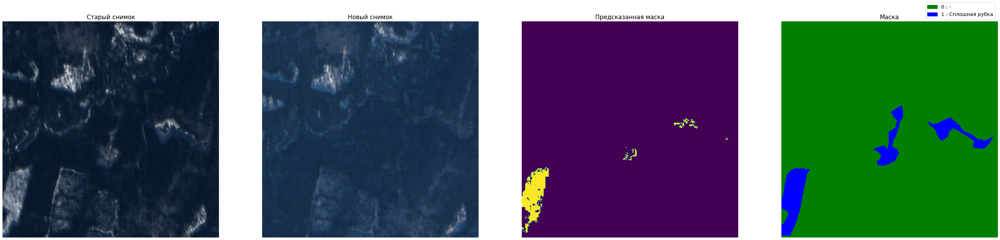

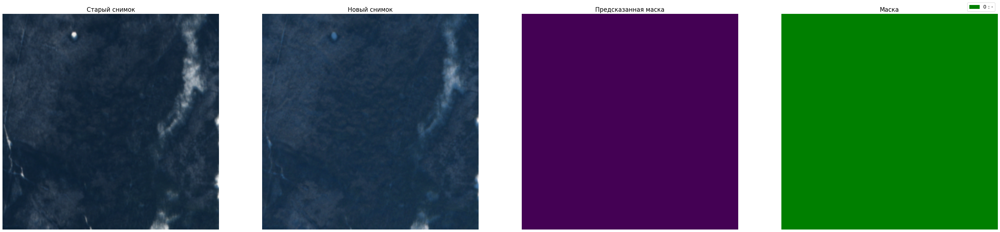

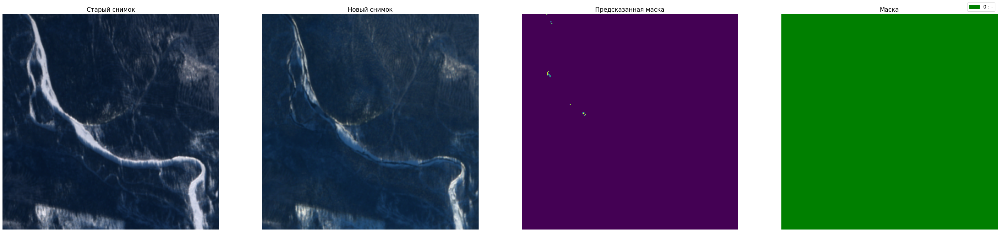

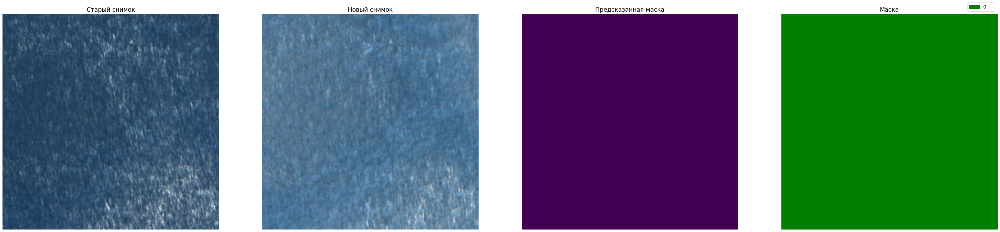

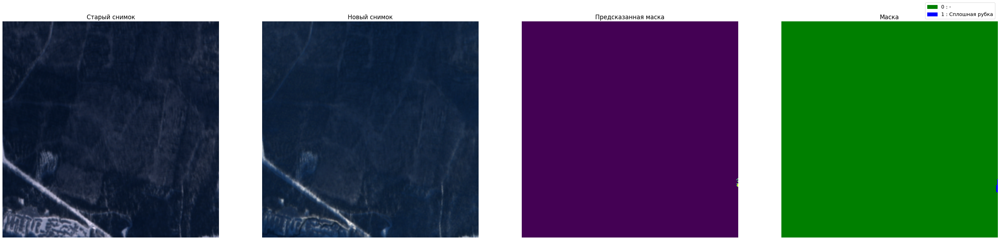

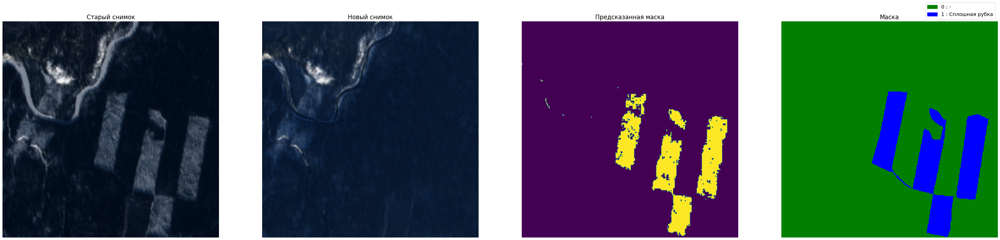

In [187]:
offset = 0         # поменяйте, чтобы посмотреть следующие 6
for i in range(6):
    fig,axes = plt.subplots(ncols=4,figsize=(50,50))

    show_img_norm(get_rgb(X_test[(i+offset)*256*256 : (i + offset + 1)*256*256].reshape(256, 256, NUM_FEATURES),3,2,1), 0)
    axes[0].set_title('Старый снимок')

    show_img_norm(get_rgb(X_test[(i+offset)*256*256 : (i + offset + 1)*256*256].reshape(256, 256, NUM_FEATURES),16,15,14), 1)
    axes[1].set_title('Новый снимок')
    
    axes[2].imshow(y_pred[(i + offset)*256*256 : (i + offset + 1)*256*256].reshape(256, 256))
    axes[2].set_title('Предсказанная маска')
    axes[2].axis('off')
    
    show_mask( y_test[(i + offset)*256*256 : (i + offset + 1)*256*256].reshape(256, 256), 3)

# XGBoost

Аналогично можно выполнить обучение другой ML-модели. Мы уже разделили и подготовили датасет в части подготовки данных, так что здесь нам остаётся только обучить модель. 

In [195]:
import xgboost as xgb

model = xgb.XGBClassifier(n_estimators=30, eval_metric=["error", "logloss"])

In [196]:
model.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=['error', 'logloss'],
              feature_types=None, gamma=None, gpu_id=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, n_estimators=30, n_jobs=None,
              num_parallel_tree=None, predictor=None, random_state=None, ...)

In [197]:
print(dice_coefficient(y_test, y_pred))

tf.Tensor(0.5891895, shape=(), dtype=float32)


Как визуализировать результаты показано в предыдущей части.

# Дополнительная часть

## Морфологические преобразования

Заметно, что маски получаются довольно прерывистые. Это объясняется тем, что классические ML-методы в отличие от свёрточных сетей не учитывают пространственную информацию и вместо целостных объектов работают с набором пикселей (одномерный массив). Из-за этого модель не может "уловить", что если на всех соседних пикселях отмечена сплошная вырубка, то и на текущем она скорее всего должна быть. 

Мы можем искусственно сгладить результирующие маски с помощью морфологических преобразований.
Морфологическим преобразования представляют собой несколько простых операций, основанных на форме изображения. Обычно они выполняются на бинарных изображениях и требуют два входа: исходное изображение, а также структурирующий элементом или ядро, которое определяет характер операции.
Использовались следующие морфологические операции:
*	Закрытие. Эрозия, а затем расширение. Это полезно для закрытия небольших отверстий внутри объектов переднего плана или небольших черных точек на объекте. 
*	Открытие. Расширение, а затем эрозия. Это полезно для удаления шума.

Параметры для этих МП уже подобраны, но можете попробовать поменять их и посмотреть, как изменятся маски.

In [188]:
y_pred_new = []

for i in range(25):
    mask = y_pred[(i)*256*256 : (i + 1)*256*256].reshape(256, 256)
    
    newImg = cv2.morphologyEx(mask.astype('float32'), cv2.MORPH_CLOSE,cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7, 7)))
    newImg2 = cv2.morphologyEx(newImg, cv2.MORPH_OPEN,cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5)))
    
    y_pred_new.append(newImg2.astype('float32'))

In [189]:
print(dice_coefficient(y_test, y_pred_new))

tf.Tensor(0.63867205, shape=(), dtype=float32)


Видим заметное улучшение Dice коэффиицента. Посмотрим также на то, как изменились маски.

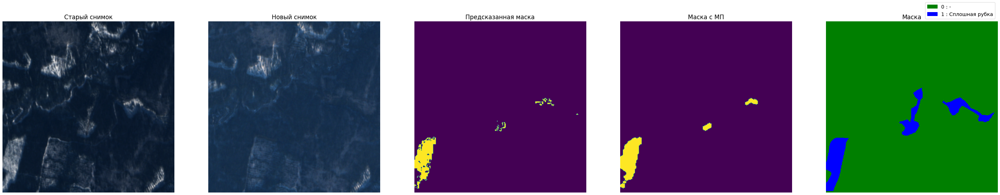

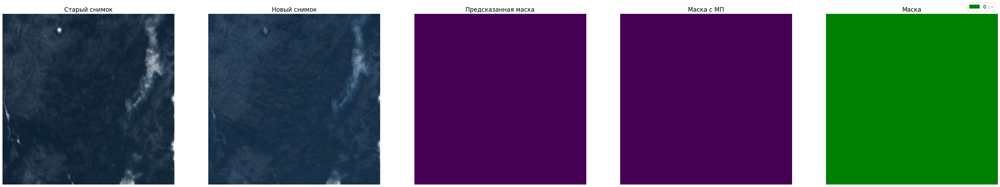

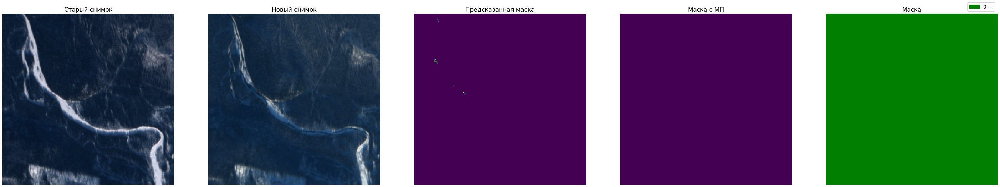

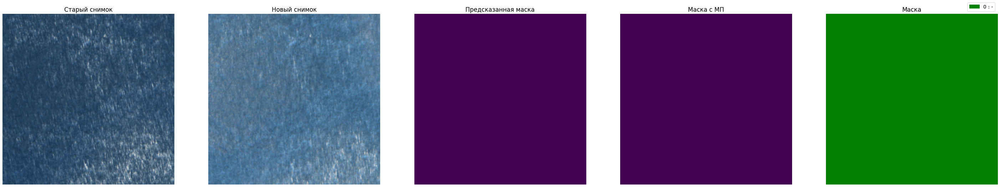

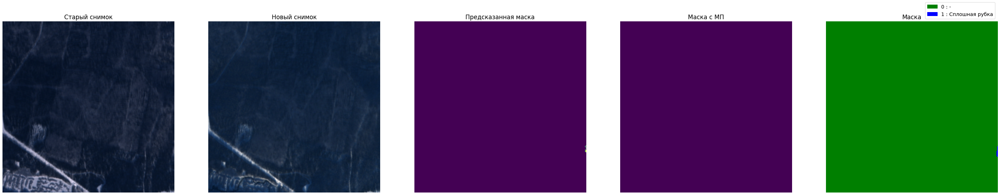

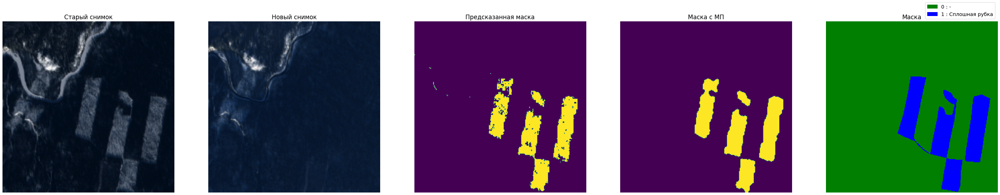

In [192]:
offset = 0         # поменяйте, чтобы посмотреть следующие 6
for i in range(6):
    fig,axes = plt.subplots(ncols=5,figsize=(50,50))

    show_img_norm(get_rgb(X_test[(i+offset)*256*256 : (i + offset + 1)*256*256].reshape(256, 256, NUM_FEATURES),3,2,1), 0)
    axes[0].set_title('Старый снимок')

    show_img_norm(get_rgb(X_test[(i+offset)*256*256 : (i + offset + 1)*256*256].reshape(256, 256, NUM_FEATURES),16,15,14), 1)
    axes[1].set_title('Новый снимок')
    
    axes[2].imshow(y_pred[(i + offset)*256*256 : (i + offset + 1)*256*256].reshape(256, 256))
    axes[2].set_title('Предсказанная маска')
    axes[2].axis('off')
    
    axes[3].imshow(y_pred_new[i + offset])
    axes[3].set_title('Маска с МП')
    axes[3].axis('off')
    
    show_mask( y_test[(i + offset)*256*256 : (i + offset + 1)*256*256].reshape(256, 256), 4)